In [4]:
import numpy as np
import cv2
import os.path as osp
from glob import glob
import matplotlib.pyplot as plt
from IPython.core.debugger import set_trace
from skimage.feature import hog
from skimage import exposure, draw
import matplotlib.lines as mlines
plt.rcParams.update({'figure.max_open_warning': 0})

def load_image(path):
  im = cv2.imread(path)
  im = im[:, :, ::-1]  # BGR -> RGB
  im = im.astype(np.float32)  # for vlfeat functions
  return im

def report_accuracy(confidences, label_vector):
  """
  Calculates various accuracy metrics on the given predictions
  :param confidences: 1D numpy array holding predicted confidence scores
  :param label_vector: 1D numpy array holding ground truth labels (same size
  as confidences
  :return: tp_rate, fp_rate, tn_rate, fn_rate
  """
  preds = confidences.copy()
  preds[preds >= 0] = 1
  preds[preds <  0] = -1

  tp = np.logical_and(preds > 0, preds==label_vector)
  fp = np.logical_and(preds > 0, preds!=label_vector)
  tn = np.logical_and(preds < 0, preds==label_vector)
  fn = np.logical_and(preds < 0, preds!=label_vector)

  N = len(label_vector)

  tp_rate = sum(tp) / (sum(tp)+sum(fn)) * 100
  fp_rate = sum(fp) / (sum(fp)+sum(tn)) * 100
  tn_rate = 100 - fp_rate
  fn_rate = 100 - tp_rate
  accuracy = (sum(tp)+sum(tn)) / N * 100

  print('Accuracy = {:4.3f}%\n'
        'True Positive rate = {:4.3f}%\nFalse Positive rate = {:4.3f}%\n'
        'True Negative rate = {:4.3f}%\nFalse Negative rate = {:4.3f}%'.
    format(accuracy, tp_rate, fp_rate, tn_rate, fn_rate))

  return tp_rate, fp_rate, tn_rate, fn_rate

def voc_ap(rec, prec):
  mrec = np.hstack((0, rec, 1))
  mpre = np.hstack((0, prec, 0))

  for i in reversed(range(len(mpre)-1)):
    mpre[i] = max(mpre[i], mpre[i+1])

  i = np.where(mrec[1:] != mrec[:-1])[0] + 1
  ap = sum((mrec[i] - mrec[i-1]) * mpre[i])
  return ap

def evaluate_detections(bboxes, confidences, image_ids, label_path, draw=True):
  """
  :param bboxes:
  :param confidences:
  :param image_ids:
  :param label_path:
  :param draw:
  :return:
  """
  gt_ids = []
  gt_bboxes = []
  with open(label_path, 'r') as f:
    for line in f:
      gt_id, xmin, ymin, xmax, ymax = line.split(' ')
      gt_ids.append(gt_id)
      gt_bboxes.append([float(xmin), float(ymin), float(xmax), float(ymax)])
  gt_bboxes = np.vstack(gt_bboxes)

  npos = len(gt_ids)
  gt_isclaimed = np.asarray([False]*len(gt_ids))


  # sort detections by decreasing confidence
  order = np.argsort(-confidences)
  confidences = confidences[order]
  image_ids = [image_ids[i] for i in order]
  bboxes = bboxes[order]

  # assign detections to GT objects
  nd = len(confidences)
  tp = np.asarray([False]*nd)
  fp = np.asarray([False]*nd)
  duplicate_detections = np.asarray([False]*nd)

  for d in range(nd):
    cur_gt_ids = [i for i, gt_id in enumerate(gt_ids) if gt_id == image_ids[d]]

    bb = bboxes[d]
    ovmax = -float('inf')

    for j in cur_gt_ids:
      bbgt = gt_bboxes[j]
      bi = [max(bb[0], bbgt[0]), max(bb[1], bbgt[1]), min(bb[2], bbgt[2]),
            min(bb[3], bbgt[3])]
      iw = bi[2] - bi[0] + 1
      ih = bi[3] - bi[1] + 1

      if (iw > 0) and (ih > 0):
        ua = (bb[2]-bb[0]+1) * (bb[3]-bb[1]+1) +\
             (bbgt[2]-bbgt[0]+1) * (bbgt[3]-bbgt[1]+1) -\
             iw*ih
        ov = iw*ih / ua
        if ov > ovmax:
          ovmax = ov
          jmax = j

    if ovmax >= 0.3:
      if not gt_isclaimed[jmax]:
        tp[d] = True
        gt_isclaimed[jmax] = True
      else:
        fp[d] = True
        duplicate_detections[d] = True
    else:
      fp[d] = True

  cum_fp = np.cumsum(fp)
  cum_tp = np.cumsum(tp)
  rec = cum_tp / npos
  prec = cum_tp / (cum_tp + cum_fp)
  ap = voc_ap(rec, prec)

  if draw:
    plt.figure()
    plt.plot(rec, prec, '-')
    plt.xlim(0, 1)
    plt.ylim(0, 1)
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Average precision = {:4.3f}'.format(ap))

    plt.figure()
    plt.plot(cum_fp, rec, '-')
    plt.xlim(0, 300)
    plt.ylim(0, 1)
    plt.xlabel('False Positives')
    plt.ylabel('Number of correct detections (recall)')
    plt.title('This figure is meant to match Fig. 6 in Viola-Jones')

  order = np.argsort(order)
  tp = tp[order]
  fp = fp[order]
  duplicate_detections = duplicate_detections[order]

  return gt_ids, gt_bboxes, gt_isclaimed, tp, fp, duplicate_detections

def visualize_detections_by_image(bboxes, confidences, image_ids, tp, fp,
    test_scn_path, label_filename, onlytp=False):
  """
  Visuaize the detection bounding boxes and ground truth on images
  :param bboxes: N x 4 numpy matrix, where N is the number of detections. Each
  row is [xmin, ymin, xmax, ymax]
  :param confidences: size (N, ) numpy array of detection confidences
  :param image_ids: N-element list of image names for each detection
  :param tp: size (N, ) numpy array of true positive indicator variables
  :param fp: size (N, ) numpy array of false positive indicator variables
  :param test_scn_path: path to directory holding test images (in .jpg format)
  :param label_filename: path to .txt file containing labels. Format is
  image_id xmin ymin xmax ymax for each row
  :param onlytp: show only true positives
  :return:
  """
  gt_ids = []
  gt_bboxes = []
  with open(label_filename, 'r') as f:
    for line in f:
      gt_id, xmin, ymin, xmax, ymax,z = line.split(' ')
      gt_ids.append(gt_id)
      gt_bboxes.append([float(xmin), float(ymin), float(xmax), float(ymax)])
  gt_bboxes = np.vstack(gt_bboxes)

  gt_file_list = list(set(gt_ids))

  for gt_file in gt_file_list:
    cur_test_image = load_image(osp.join(test_scn_path, gt_file))

    cur_gt_detections = [i for i, gt_id in enumerate(gt_ids) if gt_id == gt_file]
    cur_gt_bboxes = gt_bboxes[cur_gt_detections]

    cur_detections = [i for i, gt_id in enumerate(image_ids) if gt_id == gt_file]
    cur_bboxes = bboxes[cur_detections]
    cur_confidences = confidences[cur_detections]
    cur_tp = tp[cur_detections]
    cur_fp = fp[cur_detections]


    plt.figure()
    plt.imshow(cur_test_image.astype(np.uint8))

    for i, bb in enumerate(cur_bboxes):
      if cur_tp[i]:  # true positive
        plt.plot(bb[[0, 2, 2, 0, 0]], bb[[1, 1, 3, 3, 1]], 'g')
      elif cur_fp[i]:  # false positive
        if not onlytp:
          plt.plot(bb[[0, 2, 2, 0, 0]], bb[[1, 1, 3, 3, 1]], 'r')
      else:
        raise AssertionError

    for bb in cur_gt_bboxes:
      plt.plot(bb[[0, 2, 2, 0, 0]], bb[[1, 1, 3, 3, 1]], 'y')

    plt.axis("off")
    plt.title('{:s} (green=true pos, red=false pos, yellow=ground truth), '
              '{:d}/{:d} found'.format(gt_file, sum(cur_tp), len(cur_gt_bboxes)))

def visualize_detections_by_confidence(bboxes, confidences, image_ids,
    test_scn_path, label_filename, onlytp=False):
  """
  Visuaize the detection bounding boxes and ground truth on images, sorted by
  confidence
  :param bboxes: N x 4 numpy matrix, where N is the number of detections. Each
  row is [xmin, ymin, xmax, ymax]
  :param confidences: size (N, ) numpy array of detection confidences
  :param image_ids: N-element list of image names for each detection
  :param test_scn_path: path to directory holding test images (in .jpg format)
  :param label_filename: path to .txt file containing labels. Format is
  image_id xmin ymin xmax ymax for each row
  :param onlytp: show only true positives
  :return:
  """
  gt_ids = []
  gt_bboxes = []
  with open(label_filename, 'r') as f:
    for line in f:
      gt_id, xmin, ymin, xmax, ymax,z = line.split(' ')
      gt_ids.append(gt_id)
      gt_bboxes.append([float(xmin), float(ymin), float(xmax), float(ymax)])
  gt_bboxes = np.vstack(gt_bboxes)

  # sort detections by decreasing confidence
  order = np.argsort(-confidences)
  image_ids = [image_ids[i] for i in order]
  bboxes = bboxes[order]
  confidences = confidences[order]

  for d in range(len(confidences)):
    cur_gt_idxs = [i for i, gt_id in enumerate(gt_ids) if gt_id == image_ids[d]]
    bb = bboxes[d]
    ovmax = -float('inf')

    for j in cur_gt_idxs:
      bbgt = gt_bboxes[j]
      bi = [max(bb[0], bbgt[0]), max(bb[1], bbgt[1]), min(bb[2], bbgt[2]),
            min(bb[3], bbgt[3])]
      iw = bi[2] - bi[0] + 1
      ih = bi[3] - bi[1] + 1

      if (iw > 0) and (ih > 0):
        ua = (bb[2]-bb[0]+1) * (bb[3]-bb[1]+1) +\
             (bbgt[2]-bbgt[0]+1) * (bbgt[3]-bbgt[1]+1) -\
             iw*ih
        ov = iw*ih / ua
        if ov > ovmax:
          ovmax = ov
          jmax = j

    if onlytp and ovmax < 0.3:
      continue

    im = load_image(osp.join(test_scn_path, image_ids[d]))
    plt.figure()
    plt.imshow(im.astype(np.uint8))
    if ovmax >= 0.3:
      bbgt = gt_bboxes[jmax]
      plt.plot(bbgt[[0, 2, 2, 0, 0]], bbgt[[1, 1, 3, 3, 1]], 'y')
      plt.plot(bb[[0, 2, 2, 0, 0]], bb[[1, 1, 3, 3, 1]], 'g')
    else:
      plt.plot(bb[[0, 2, 2, 0, 0]], bb[[1, 1, 3, 3, 1]], 'r')
    plt.title('Image {:s} [{:d}/{:d}], (green=true pos, red=false pos, '
              'yellow=ground truth)'.format(image_ids[d], d, len(confidences)))


def visualize_detections_by_image_no_gt(bboxes, confidences, image_ids,
    test_scn_path):
  """
  Visualize detection bounding boxes on images that don't have ground truth
  labels
  :param bboxes: N x 4 numpy matrix, where N is the number of detections. Each
  row is [xmin, ymin, xmax, ymax]
  :param confidences: size (N, ) numpy array of detection confidences
  :param image_ids: N-element list of image names for each detection
  :param test_scn_path: path to directory holding test images (in .jpg format)
  :return:
  """
  test_filenames = glob(osp.join(test_scn_path, '*.png'))

  for im_filename in test_filenames:
    test_id = im_filename.split('/')[-1]
    test_id = test_id.split('\\')[-1] # in case the file path use backslash
    cur_test_image = load_image(im_filename)
    cur_detections = [i for i, im_id in enumerate(image_ids) if im_id == test_id]
    cur_bboxes = bboxes[cur_detections]
    cur_confidences = confidences[cur_detections]

    #plt.figure()
    plt.imshow(cur_test_image.astype(np.uint8))
    
    for bb in cur_bboxes:
      plt.plot(bb[[0, 2, 2, 0, 0]], bb[[1, 1, 3, 3, 1]], 'g')
    plt.title('{:s} green=detection'.format(test_id))
    plt.show()

In [5]:
import os
#import utils
import matplotlib.pyplot as plt

positive_train_data_path = '/Users/park/Desktop/vision_project/INRIAPerson/96X160H96/Train/pos'
positive_data_list = os.listdir(positive_train_data_path)
#print(data_list)

negative_train_data_path = '/Users/park/Desktop/vision_project/INRIAPerson/Train/neg'
negative_data_list = os.listdir(negative_train_data_path)
#print(data_list)


Test_data_path = '/Users/park/Desktop/vision_project/INRIAPerson/Test/pos'
test_data_list = os.listdir(Test_data_path)

already_calculated = True
clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(8,8))

In [6]:
import cv2
import random
import pickle
already_calculated = True
if not already_calculated:
    hog = cv2.HOGDescriptor()

    hog_list = []
    label_list = []
    k = 0
    for imgpath in positive_data_list:
        print(k/len(positive_data_list))
        k = k + 1
        #print('/INRIAPerson/96X160H96/Train/pos/'+imgpath)
        img = cv2.imread('./INRIAPerson/96X160H96/Train/pos/'+imgpath)
        img = img[16:16+128,16:16+64,:]
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        #gray = cv2.equalizeHist(gray)
        gray = cv2.normalize(gray, None, 0, 255, cv2.NORM_MINMAX)
        #print(img.shape)
        #cv2.imshow("cropped", crop_img)
        h = hog.compute(gray)
        #h = (h - np.min(h))/(np.max(h) - np.min(h))
        hog_list.append(h.flatten())
        label_list.append(1)

    sample_per_nagative_img = 100
    k = 0
    for imgpath in negative_data_list:
        
        print(k/len(negative_data_list))
        k = k + 1
        #print('/INRIAPerson/Train/neg'+imgpath)
        
        #random.uniform(1, 1.9)
        
        img = cv2.imread('./INRIAPerson/Train/neg/'+imgpath)
        [y,x,z] = img.shape
        #img[:,:,0] = clahe.apply(img_clahe[:,:,0])  
        for i in range(sample_per_nagative_img):
            
            s = random.uniform(1, 3)
            
            img_tmp = cv2.resize(img, dsize=(int(x/s), int(y/s)))
            
            a = random.randint(0,3)
            if a == 0 :
                img_tmp = cv2.flip(img_tmp, 1)
            elif a == 1:
                img_tmp = cv2.flip(img_tmp, -1)
            elif a == 2:
                img_tmp = cv2.flip(img_tmp, 0)
            
            
            
            rand_x = random.randrange(0,int(x/s) - 64)
            rand_y = random.randrange(0,int(y/s) - 128)
            sampled_img = img_tmp[rand_y:rand_y + 128, rand_x :rand_x + 64,:]
            #print(rand_x)
            #print(rand_y)
            #print(x,y,z)
            #print(img.shape)

            gray = cv2.cvtColor(sampled_img, cv2.COLOR_BGR2GRAY)
            gray = cv2.normalize(gray, None, 0, 255, cv2.NORM_MINMAX)
            #gray = cv2.equalizeHist(gray)
            #print(img.shape)
            #cv2.imshow("cropped", crop_img)
            h = hog.compute(gray)
            #h = (h - np.min(h))/(np.max(h) - np.min(h))
            hog_list.append(h.flatten())
            label_list.append(-1)

    #3780
    #2416
    

    with open('hog_list.pickle', 'wb') as f:
        pickle.dump(hog_list, f)
    with open('label_list.pickle', 'wb') as f:
        pickle.dump(label_list, f) 

0.0
0.0004139072847682119
0.0008278145695364238
0.0012417218543046358
0.0016556291390728477
0.0020695364238410598
0.0024834437086092716
0.0028973509933774835
0.0033112582781456954
0.0037251655629139072
0.0041390728476821195
0.004552980132450331
0.004966887417218543
0.005380794701986755
0.005794701986754967
0.006208609271523178
0.006622516556291391
0.007036423841059603
0.0074503311258278145
0.007864238410596027
0.008278145695364239
0.00869205298013245
0.009105960264900662
0.009519867549668874
0.009933774834437087
0.010347682119205299
0.01076158940397351
0.011175496688741722
0.011589403973509934
0.012003311258278146
0.012417218543046357
0.01283112582781457
0.013245033112582781
0.013658940397350994
0.014072847682119206
0.014486754966887417
0.014900662251655629
0.015314569536423841
0.015728476821192054
0.016142384105960264
0.016556291390728478
0.01697019867549669
0.0173841059602649
0.017798013245033113
0.018211920529801324
0.018625827814569538
0.01903973509933775
0.01945364238410596
0.0198

0.22019867549668873
0.22061258278145696
0.22102649006622516
0.22144039735099338
0.22185430463576158
0.2222682119205298
0.222682119205298
0.2230960264900662
0.22350993377483444
0.22392384105960264
0.22433774834437087
0.22475165562913907
0.2251655629139073
0.2255794701986755
0.2259933774834437
0.22640728476821192
0.22682119205298013
0.22723509933774835
0.22764900662251655
0.22806291390728478
0.22847682119205298
0.22889072847682118
0.2293046357615894
0.2297185430463576
0.23013245033112584
0.23054635761589404
0.23096026490066227
0.23137417218543047
0.23178807947019867
0.2322019867549669
0.2326158940397351
0.23302980132450332
0.23344370860927152
0.23385761589403972
0.23427152317880795
0.23468543046357615
0.23509933774834438
0.23551324503311258
0.2359271523178808
0.236341059602649
0.2367549668874172
0.23716887417218543
0.23758278145695363
0.23799668874172186
0.23841059602649006
0.2388245033112583
0.2392384105960265
0.2396523178807947
0.24006622516556292
0.24048013245033112
0.2408940397350993

0.451158940397351
0.4515728476821192
0.4519867549668874
0.45240066225165565
0.45281456953642385
0.45322847682119205
0.45364238410596025
0.45405629139072845
0.4544701986754967
0.4548841059602649
0.4552980132450331
0.4557119205298013
0.45612582781456956
0.45653973509933776
0.45695364238410596
0.45736754966887416
0.45778145695364236
0.4581953642384106
0.4586092715231788
0.459023178807947
0.4594370860927152
0.4598509933774834
0.4602649006622517
0.4606788079470199
0.4610927152317881
0.4615066225165563
0.46192052980132453
0.46233443708609273
0.46274834437086093
0.46316225165562913
0.46357615894039733
0.4639900662251656
0.4644039735099338
0.464817880794702
0.4652317880794702
0.4656456953642384
0.46605960264900664
0.46647350993377484
0.46688741721854304
0.46730132450331124
0.46771523178807944
0.4681291390728477
0.4685430463576159
0.4689569536423841
0.4693708609271523
0.46978476821192056
0.47019867549668876
0.47061258278145696
0.47102649006622516
0.47144039735099336
0.4718543046357616
0.4722682

0.6808774834437086
0.6812913907284768
0.6817052980132451
0.6821192052980133
0.6825331125827815
0.6829470198675497
0.6833609271523179
0.6837748344370861
0.6841887417218543
0.6846026490066225
0.6850165562913907
0.6854304635761589
0.6858443708609272
0.6862582781456954
0.6866721854304636
0.6870860927152318
0.6875
0.6879139072847682
0.6883278145695364
0.6887417218543046
0.6891556291390728
0.6895695364238411
0.6899834437086093
0.6903973509933775
0.6908112582781457
0.6912251655629139
0.6916390728476821
0.6920529801324503
0.6924668874172185
0.6928807947019867
0.6932947019867549
0.6937086092715232
0.6941225165562914
0.6945364238410596
0.6949503311258278
0.695364238410596
0.6957781456953642
0.6961920529801324
0.6966059602649006
0.6970198675496688
0.6974337748344371
0.6978476821192053
0.6982615894039735
0.6986754966887417
0.6990894039735099
0.6995033112582781
0.6999172185430463
0.7003311258278145
0.7007450331125827
0.7011589403973509
0.7015728476821192
0.7019867549668874
0.7024006622516556
0.7028

0.9072847682119205
0.9076986754966887
0.9081125827814569
0.9085264900662252
0.9089403973509934
0.9093543046357616
0.9097682119205298
0.910182119205298
0.9105960264900662
0.9110099337748344
0.9114238410596026
0.9118377483443708
0.9122516556291391
0.9126655629139073
0.9130794701986755
0.9134933774834437
0.9139072847682119
0.9143211920529801
0.9147350993377483
0.9151490066225165
0.9155629139072847
0.9159768211920529
0.9163907284768212
0.9168046357615894
0.9172185430463576
0.9176324503311258
0.918046357615894
0.9184602649006622
0.9188741721854304
0.9192880794701986
0.9197019867549668
0.9201158940397351
0.9205298013245033
0.9209437086092715
0.9213576158940397
0.921771523178808
0.9221854304635762
0.9225993377483444
0.9230132450331126
0.9234271523178808
0.9238410596026491
0.9242549668874173
0.9246688741721855
0.9250827814569537
0.9254966887417219
0.9259105960264901
0.9263245033112583
0.9267384105960265
0.9271523178807947
0.9275662251655629
0.9279801324503312
0.9283940397350994
0.9288079470198

ValueError: empty range for randrange() (0, -30, -30)

In [7]:
with open('hog_list.pickle', 'rb') as f:
    hog_list = pickle.load(f)
with open('label_list.pickle', 'rb') as f:
    lable_list = pickle.load(f)

In [8]:
already_calculated =True
if not already_calculated:
    from sklearn import svm
    clf = svm.LinearSVC(max_iter = 50000000)
    clf.fit(hog_list, lable_list)
    with open('classifier.pickle', 'wb') as f:
        pickle.dump(clf, f)

In [9]:
with open('classifier.pickle', 'rb') as f:
    clf = pickle.load(f)

In [10]:
import numpy as np

ssgcale_list = [1,1.1,1.2,1.3,1.4,1.5,1.75,1.9,2,2.1,2.25,2.5,2.6,2.75,3,3.2,3.4,3.6,3.8,4,4.2,4.5]

hog = cv2.HOGDescriptor()
detect_list = []
detect_list_prob = []
threshold = 0.1
k =1
a = len(test_data_list)
already_calculated = False
if not already_calculated:
    for imgpath in test_data_list:
        detect_list.append([])
        detect_list_prob.append([])
        img = cv2.imread('./INRIAPerson/Test/pos/'+imgpath)
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        
        
        #gray = cv2.normalize(gray, None, 0, 255, cv2.NORM_MINMAX)
        #gray = cv2.equalizeHist(gray)
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
        #gray = clahe.apply(gray)
        gray = cv2.normalize(gray, None, 0, 255, cv2.NORM_MINMAX)
        
        [y,x] = gray.shape
        print(k/a)
        k = k+1
        
        ssgy = (y/128)
        ssgx = (x/64)
        ssgcale_list = []
        ssgm = min(ssgy,ssgx)
        ssgM = max(ssgy,ssgx)
        sk = 1
        while sk<ssgM:
            ssgcale_list.append(sk)
            sk = sk * 1.1
        ssgcale_list.append(sk)
        
        for s in ssgcale_list:
            if int(x/s)>64 and int(y/s)>128:
                gray_tmp = cv2.resize(gray, dsize=(int(x/s), int(y/s)))
                [ys,xs] = gray_tmp.shape
                for i in range(round((ys - 128)/16) ):
                    for j in range(round((xs - 64)/8) ):
                        cropped_gray = gray_tmp[i*16:i*16+128,j*8:j*8+64]
                        h = hog.compute(cropped_gray)
                        #h = (h - np.min(h))/(np.max(h) - np.min(h))
                        prob = np.dot(h.transpose(),clf.coef_.transpose())+clf.intercept_

                        #print(prob)
                        
                        threshold =1/(s**2)
                        if s<1.7:
                            threshold = 5/(s**3)
                        if s>2.4:
                            threshold *= 0.5
                        
                        if(prob>threshold):
                            coordi = [i,j,prob[0][0]]
                            detect_list_prob[-1].append(s)
                            #print(prob[0][0])
                            detect_list[-1].append(coordi)
        print(len(detect_list[-1]))
    with open('detection_list.pickle', 'wb') as f:
        pickle.dump(detect_list, f)
    with open('detection_list_prob.pickle', 'wb') as f:
        pickle.dump(detect_list_prob, f)

0.003472222222222222
27
0.006944444444444444
31
0.010416666666666666
37
0.013888888888888888
7
0.017361111111111112
6
0.020833333333333332
10
0.024305555555555556
1
0.027777777777777776
4
0.03125
11
0.034722222222222224
6
0.03819444444444445
11
0.041666666666666664
68
0.04513888888888889
22
0.04861111111111111
12
0.052083333333333336
7
0.05555555555555555
21
0.059027777777777776
0
0.0625
3
0.06597222222222222
0
0.06944444444444445
3
0.07291666666666667
26
0.0763888888888889
34
0.0798611111111111
27
0.08333333333333333
8
0.08680555555555555
56
0.09027777777777778
1
0.09375
18
0.09722222222222222
13
0.10069444444444445
9
0.10416666666666667
8
0.1076388888888889
2
0.1111111111111111
2
0.11458333333333333
16
0.11805555555555555
7
0.12152777777777778
10
0.125
29
0.1284722222222222
22
0.13194444444444445
3
0.13541666666666666
4
0.1388888888888889
5
0.1423611111111111
5
0.14583333333333334
5
0.14930555555555555
7
0.1527777777777778
41
0.15625
62
0.1597222222222222
23
0.16319444444444445
10
0.

In [18]:
with open('detection_list.pickle', 'rb') as f:
    detect_list = pickle.load(f)
with open('detection_list_prob.pickle', 'rb') as f:
    detect_list_prob = pickle.load(f)

k_total = 0
detect_list_boolean = []#np.ones((len(detect_list),len(detect_list[0])), dtype=bool)
#for i in range(len(detect_list)):
#    detect_list[i].sort(key=lambda x: x[2])
    
#if not already_calculated:
for iter in range(len(detect_list)):
    k = 0
    k_total += len(detect_list[iter])
    detect_list_boolean.append(np.ones((len(detect_list[iter])), dtype=bool))
    for i in range(len(detect_list[iter])):
        for j in range(len(detect_list[iter])):
            l = j 
            if(l!=i):
                if detect_list_boolean[iter][i] == True and detect_list_boolean[iter][l] == True:
                    l = j

                    ssgcale = detect_list_prob[iter][i]
                    xmin1 = detect_list[iter][i][1]*ssgcale*8 
                    ymin1 = detect_list[iter][i][0]*ssgcale*16 
                    xmax1 = detect_list[iter][i][1]*ssgcale*8 + ssgcale*64
                    ymax1 = detect_list[iter][i][0]*ssgcale*16 + ssgcale*128
                    
                    lx1 = xmax1 - xmin1
                    ly1 = ymax1 - ymin1

                    ssgcale2 = detect_list_prob[iter][j]
                    xmin2 = detect_list[iter][l][1]*ssgcale2*8 
                    ymin2 = detect_list[iter][l][0]*ssgcale2*16 
                    xmax2 = detect_list[iter][l][1]*ssgcale2*8 + ssgcale2*64
                    ymax2 = detect_list[iter][l][0]*ssgcale2*16 + ssgcale2*128
                    #print(i,l)
                    #print(xmin1,xmax1,ymin1,ymax1)
                    #print(xmin2,xmax2,ymin2,ymax2)
                    
                    lx2 = xmax2 - xmin2
                    ly2 = ymax2 - ymin2

                    inter_x = min(xmax2,xmax1) - max(xmin1,xmin2)
                    inter_y = min(ymax2,ymax1) - max(ymin1,ymin2)
                    if inter_x>0 and inter_y>0:
                        #print('test')
                        area1 = (xmax1 - xmin1)*(ymax1 - ymin1)
                        area2 = (xmax2 - xmin2)*(ymax2 - ymin2)

                        duplicate_ratio = inter_x*inter_y/(area1 + area2 - inter_x*inter_y)
                        if  duplicate_ratio > 0.3:
                            k_total -= 1
                            k = k + 1
                            #detect_list[iter][i] = 0
                            if(detect_list[iter][i][2]<detect_list[iter][l][2]) :
                                detect_list_boolean[iter][i]=(False)
                            else:
                                detect_list_boolean[iter][l]=(False)
                        
                        elif inter_x == xmax1 - xmin1 and inter_y == ymax1 - ymin1:
                            #print('test')
                            detect_list_boolean[iter][i]=(False)
                            k_total -= 1
                        elif inter_x == xmax2 - xmin2 and inter_y == ymax2 - ymin2:
                            detect_list_boolean[iter][l]=(False)
                            k_total -= 1
                        #elif   xmin2 < (xmax1 + xmin1)/2 < xmax2 and ymin2 < (ymax1 + ymin1)/2 < ymax2:
                        #    detect_list_boolean[iter][i]=(False)
                        #    k_total -= 1

    imgpath = test_data_list[iter]
    print(imgpath)
    #img = cv2.imread('./INRIAPerson/Test/pos/'+imgpath)
    #gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    #plt.imshow(gray,cmap="gray")
    #plt.show()
    print(iter)
    if len(detect_list[iter])>0:
        print( k/len(detect_list[iter]))

person_323.png
0
0.8518518518518519
person_337.png
1
0.9032258064516129
crop001545.png
2
0.7297297297297297
person_135.png
3
0.42857142857142855
person_and_bike_099.png
4
0.6666666666666666
person_and_bike_066.png
5
0.7
person_and_bike_072.png
6
0.0
person_055.png
7
0.25
person_096.png
8
0.5454545454545454
person_and_bike_112.png
9
0.6666666666666666
person_and_bike_106.png
10
0.5454545454545454
crop001633.png
11
0.8676470588235294
person_280.png
12
0.9090909090909091
person_and_bike_107.png
13
0.6666666666666666
person_and_bike_113.png
14
0.5714285714285714
person_040.png
15
0.9047619047619048
person_and_bike_073.png
16
person_and_bike_067.png
17
0.3333333333333333
person_and_bike_098.png
18
person_134.png
19
0.3333333333333333
person_120.png
20
0.8461538461538461
crop001544.png
21
0.7352941176470589
crop001593.png
22
0.7777777777777778
person_336.png
23
0.75
crop001546.png
24
0.8214285714285714
person_136.png
25
0.0
person_122.png
26
0.7222222222222222
person_and_bike_071.png
27
0.53

crop001639.png
235
0.875
person_088.png
236
0.9166666666666666
person_249.png
237
0.7931034482758621
person_248.png
238
0.8333333333333334
crop001604.png
239
0.8
person_089.png
240
0.9615384615384616
crop001638.png
241
0.8531468531468531
person_076.png
242
person_062.png
243
0.5
person_and_bike_079.png
244
0.5
person_and_bike_045.png
245
0.25
person_and_bike_051.png
246
0.5
person_and_bike_086.png
247
0.6666666666666666
person_and_bike_092.png
248
0.25
crop001566.png
249
0.0
person_314.png
250
0.75
person_and_bike_096.png
251
0.5
person_and_bike_082.png
252
0.5555555555555556
person_and_bike_069.png
253
0.8571428571428571
person_and_bike_055.png
254
0.3333333333333333
person_099.png
255
0.6923076923076923
person_and_bike_109.png
256
0.6153846153846154
person_265.png
257
0.5714285714285714
person_and_bike_108.png
258
0.5
person_098.png
259
0.6
person_073.png
260
0.0
person_and_bike_054.png
261
0.5
person_and_bike_083.png
262
0.0
person_107.png
263
0.6153846153846154
person_and_bike_097.

In [19]:
print(k_total)
bboxes = np.zeros((k_total, 4))
confidences = np.zeros((k_total))
image_ids = []

test_scn_path = './INRIAPerson/Test/pos/'
k = 0

for iter in range(len(detect_list)):
    tmp_bboxes = []
    for i in range(len(detect_list[iter])):
        if detect_list_boolean[iter][i] == True:
            
            ssgcale = detect_list_prob[iter][i]
            
            xmin1 = detect_list[iter][i][1]*ssgcale*8 
            ymin1 = detect_list[iter][i][0]*ssgcale*16 
            xmax1 = detect_list[iter][i][1]*ssgcale*8 + ssgcale*64
            ymax1 = detect_list[iter][i][0]*ssgcale*16 + ssgcale*128
            
            image_ids.append(test_data_list[iter])
            bboxes[k] = np.array([xmin1,ymin1,xmax1,ymax1])
            confidences[k] = detect_list[iter][i][2]
            
            k = k + 1
    

831


(['crop001501.png',
  'crop001501.png',
  'crop001501.png',
  'crop001501.png',
  'crop001504.png',
  'crop001504.png',
  'crop001511.png',
  'crop001512.png',
  'crop001512.png',
  'crop001512.png',
  'crop001514.png',
  'crop001514.png',
  'crop001514.png',
  'crop001520.png',
  'crop001520.png',
  'crop001521.png',
  'crop001521.png',
  'crop001521.png',
  'crop001521.png',
  'crop001521.png',
  'crop001521.png',
  'crop001522.png',
  'crop001522.png',
  'crop001522.png',
  'crop001531.png',
  'crop001531.png',
  'crop001533.png',
  'crop001533.png',
  'crop001533.png',
  'crop001533.png',
  'crop001533.png',
  'crop001544.png',
  'crop001544.png',
  'crop001545.png',
  'crop001546.png',
  'crop001546.png',
  'crop001549.png',
  'crop001555.png',
  'crop001555.png',
  'crop001555.png',
  'crop001555.png',
  'crop001555.png',
  'crop001566.png',
  'crop001566.png',
  'crop001573.png',
  'crop001573.png',
  'crop001573.png',
  'crop001573.png',
  'crop001573.png',
  'crop001574.png',


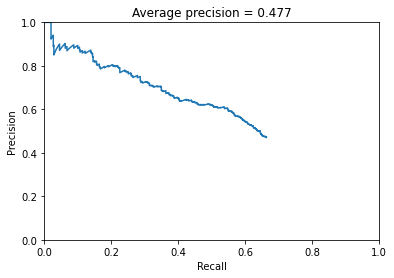

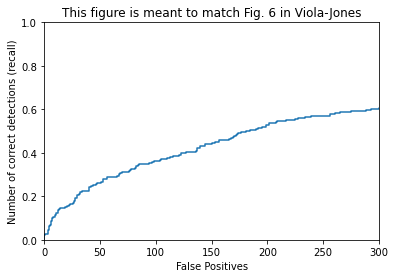

In [20]:
#label_path = '/Users/park/Desktop/vision_project/test_result.pkl'
#import utils2

label_path = '/Users/park/Desktop/vision_project/test2.txt'

evaluate_detections(bboxes,confidences,image_ids, label_path)

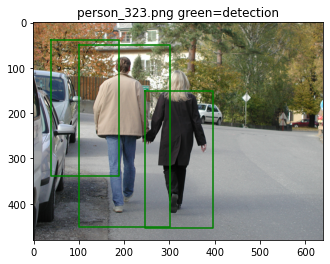

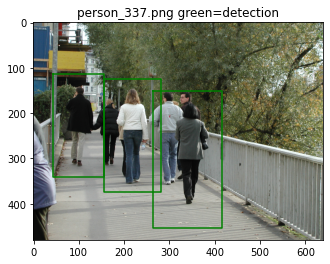

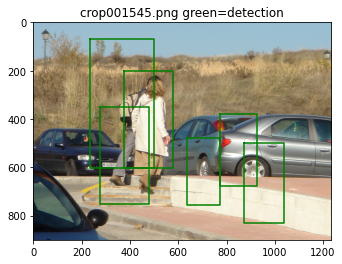

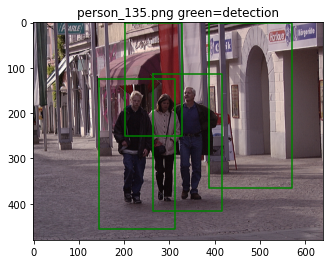

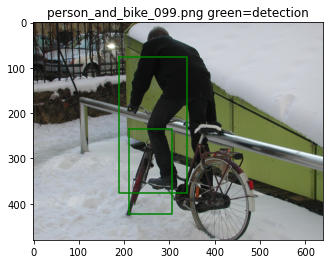

...

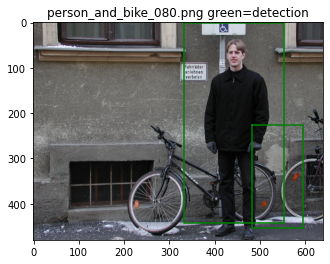

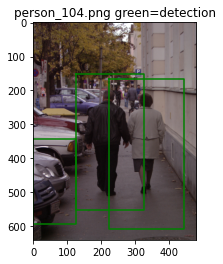

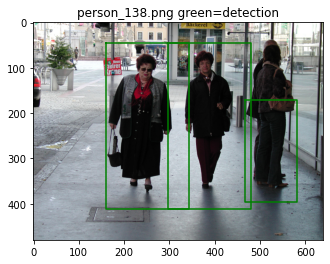

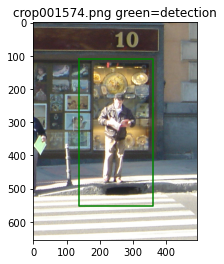

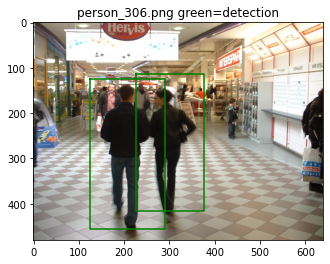

In [21]:

visualize_detections_by_image_no_gt(bboxes,confidences,image_ids,test_scn_path)